## Ellipse detection project 2022

In [ ]:
import Pkg

# activate parent environment
Pkg.activate(normpath(joinpath(@__DIR__, ".")))
Pkg.resolve()
Pkg.instantiate()
Pkg.status()

using COSMO
using DSP
using Colors
using Plots
using JuMP
using FileIO
using Colors
using ImageShow
using LinearAlgebra

  Activating project at `c:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification`
  No Changes to `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Project.toml`
  No Changes to `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Manifest.toml`


Status `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Project.toml`
  [5ae59095] Colors v0.13.0
  [717857b8] DSP v0.7.10
  [5789e2e9] FileIO v1.16.4
  [4e3cecfd] ImageShow v0.3.8
  [4076af6c] JuMP v1.23.4
  [91a5bcdd] Plots v1.40.9


## Load the image

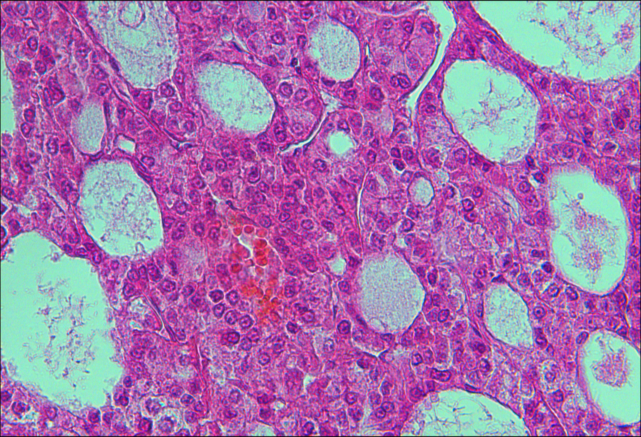

In [2]:
img = load("liver_tissue.jpg")

## Building the edge detector 

Mexican hat wavelet:

\begin{equation}
    \psi (x,y)={\frac {1}{\pi \sigma ^{4}}}\left(1-{\frac {1}{2}}\left({\frac {x^{2}+y^{2}}{\sigma ^{2}}}\right)\right)e^{-{\frac {x^{2}+y^{2}}{2\sigma ^{2}}}}
\end{equation}

In [ ]:
# build the mexican hat filter
function mexican_hat_filter(n)
    filter = zeros(n, n)
    for i in 1:n
        for j in 1:n
            x = i - n/2
            y = j - n/2
            filter[i, j] = (1 - (x^2 + y^2) / (n^2)) * exp(-(x^2 + y^2) / (2 * n^2))
        end
    end
    return filter
end

# convert the image img to black and white
function to_black_and_white(img::Matrix)
    bw_img = Matrix{Gray}(undef, size(img))
    for i in 1:size(img, 1)
        for j in 1:size(img, 2)
            bw_img[i, j] = Gray(img[i, j])
        end
    end
    return bw_img
end

to_black_and_white (generic function with 1 method)

In [ ]:
function canny_edge_detector(f_smooth::Matrix{Float64}, d1::Float64=0.1, d2::Float64=0.1)
    # Dimensions of the image
    rows, cols = size(f_smooth)

    # Preallocate arrays for gradient and Laplacian
    gradient_magnitude = zeros(Float64, rows, cols)
    laplacian_magnitude = zeros(Float64, rows, cols)
    edge_matrix = zeros(Bool, rows, cols)  # Binary matrix for edges

    # Sobel filters
    sobel_x = [-1 0 1; -2 0 2; -1 0 1]
    sobel_y = [-1 -2 -1; 0 0 0; 1 2 1]
    sobel_xx = [-1 2 -1; 2 -4 2; -1 2 -1]
    sobel_yy = [-1 2 -1; 2 -4 2; -1 2 -1]

    # Convolve the image with the Sobel filters
    gradient_x = conv(f_smooth, sobel_x)
    gradient_y = conv(f_smooth, sobel_y)

    # Compute the gradient magnitude
    gradient_magnitude = sqrt.(gradient_x.^2 + gradient_y.^2)

    # second derivative
    gradient_xx = conv(f_smooth, sobel_xx)
    gradient_yy = conv(f_smooth, sobel_yy)
    laplacian_magnitude = sqrt.(gradient_xx.^2 + gradient_yy.^2)

    # thresholding with d1, d2
    for i in 1:rows
        for j in 1:cols
            if gradient_magnitude[i, j] > d1 && laplacian_magnitude[i, j] < d2
                edge_matrix[i, j] = true
            end
        end
    end

    return edge_matrix, gradient_magnitude, laplacian_magnitude
end

canny_edge_detector (generic function with 3 methods)

## Apply filter

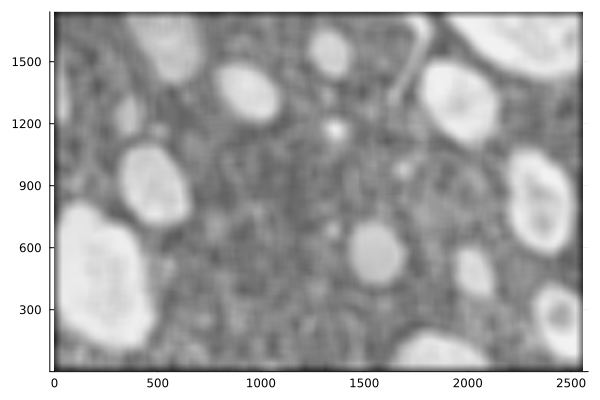

In [12]:
# Example usage
K = 80
bw_img = to_black_and_white(img)
filter = mexican_hat_filter(K)

# apply the filter to the image by convolution
filt_img = DSP.conv(Matrix{Float64}(bw_img), filter)
# cut off edges to make the image the same size as the original
N, M = size(filt_img)
filt_img = filt_img[Int(K/2)+1:N-Int(K/2), Int(K/2)+1:M-Int(K/2)]

# flip upside down
filt_img = filt_img[end:-1:1, :]
heatmap(filt_img, color=:grays, aspect_ratio=1, cbar=false)

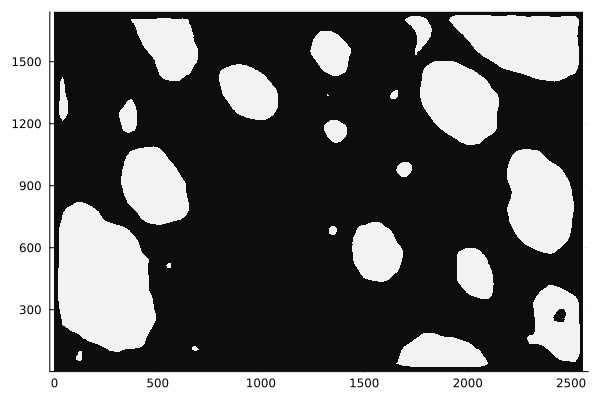

In [13]:
# apply thresholding to the filtered image
# rescale the image to 0-1
filt_img = (filt_img .- minimum(filt_img)) / (maximum(filt_img) - minimum(filt_img))
th_img = Matrix{Bool}([filt_img[i, j] > 0.7 ? 1.0 : 0.0 for i in 1:size(filt_img, 1), j in 1:size(filt_img, 2)])
heatmap(th_img, color=:grays, aspect_ratio=1, cbar=false)

## Apply thresholding (canny edge detector)

In [14]:
function link_edges(edge_image::Matrix; max_distance=2)
    """
    Links edges in a binary image to form closed shapes.

    Parameters:
    - edge_image: Binary image (output of an edge detector).
    - max_distance: Maximum distance to link edges.

    Returns:
    - Linked edge image as a binary array.
    """
    # Dimensions of the image
    rows, cols = size(edge_image)

    # Helper function to check if a coordinate is within bounds
    function in_bounds(x, y)
        return 1 <= x <= rows && 1 <= y <= cols
    end

    # Helper function to find neighbors of a pixel within a certain distance
    function get_neighbors(x, y, max_distance)
        neighbors = []
        for dx in -max_distance:max_distance
            for dy in -max_distance:max_distance
                if dx == 0 && dy == 0
                    continue
                end
                nx, ny = x + dx, y + dy
                if in_bounds(nx, ny) && edge_image[nx, ny]
                    push!(neighbors, (nx, ny))
                end
            end
        end
        return neighbors
    end

    # Create a copy of the edge image to modify
    linked_image = copy(edge_image)

    # Iterate through each pixel in the image
    for x in 1:rows
        for y in 1:cols
            if linked_image[x, y]
                # Get all neighbors within the maximum distance
                neighbors = get_neighbors(x, y, max_distance)

                # Connect this pixel to all neighbors by filling gaps
                for (nx, ny) in neighbors
                    for i in min(x, nx):max(x, nx)
                        for j in min(y, ny):max(y, ny)
                            linked_image[i, j] = true
                        end
                    end
                end
            end
        end
    end

    return linked_image
end

link_edges (generic function with 1 method)

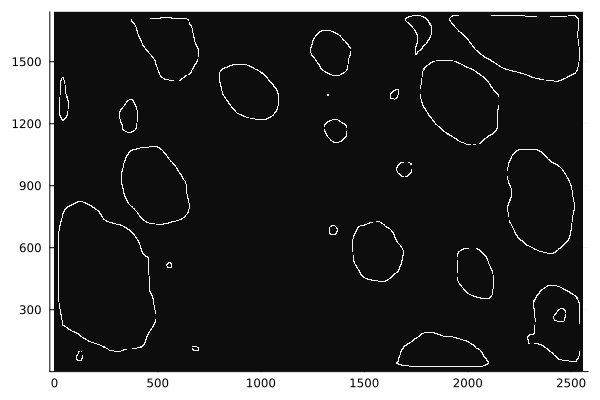

In [15]:
d1 = 0.3
d2 = 3.01

# Detect edges
edges, gradients, laplacians = canny_edge_detector(Matrix{Float64}(th_img), d1, d2)
linked_edges = link_edges(edges)

heatmap(linked_edges, color=:grays, aspect_ratio=1, cbar=false)

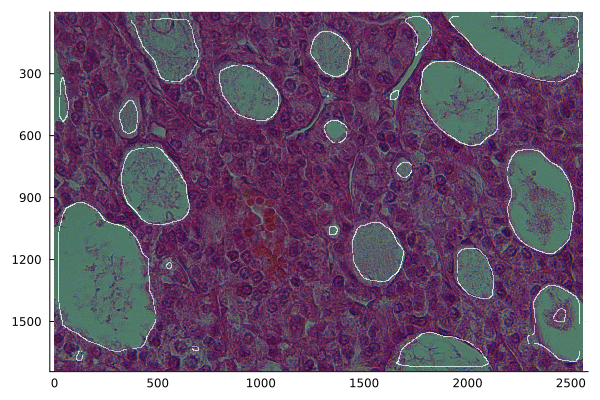

In [16]:
# overlay the edges on top of the original image
plt_res = heatmap(img, aspect_ratio=1, cbar=false)
heatmap!(plt_res, linked_edges[end:-1:1, :], color=:grays, aspect_ratio=1, cbar=false, alpha=0.5)
savefig(plt_res, "liver_tissue_edges.png")
display(plt_res)

## Select region of interest

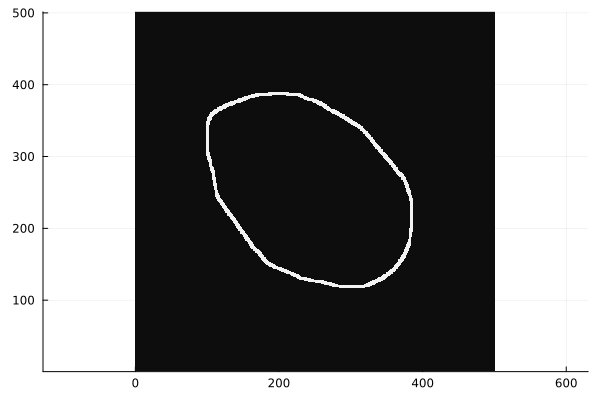

In [294]:
# select a region of interest
x_roi = (1100, 1600)
y_roi = (700, 1200)

roi = linked_edges[x_roi[1]:x_roi[2], y_roi[1]:y_roi[2]]
heatmap(roi, color=:grays, aspect_ratio=1, cbar=false)

## Define the model

In [295]:
function ellipse(Ξ::Array{Tuple{Int, Int}, 1})
    """
    Model to fit an ellipse to a binary image with edges (1)
    """
    # create a JuMP model
    m = Model(COSMO.Optimizer)

    # setup variables Q, d, e
    @variable(m, Q[1:2, 1:2], PSD)
    @variable(m, d[1:2])
    @variable(m, e)

    ϵ = 1e-3
    @constraint(m, Q - ϵ * I in PSDCone())

    # collect all points on the ellipse
    W, H = size(roi)
    N = length(Ξ)

    # residual distance to the ellipse
    @expression(m, r[i=1:N], [Ξ[i][1], Ξ[i][2], 1]' * [Q d; d' e] * [Ξ[i][1], Ξ[i][2], 1])

    return m
end

ellipse (generic function with 2 methods)

In [296]:
Ξ = [(i, j) for i in 1:W, j in 1:H if roi[i, j]]  # points on the ellipse
emodel = ellipse(Ξ)

A JuMP Model
├ solver: COSMO
├ objective_sense: FEASIBILITY_SENSE
├ num_variables: 6
├ num_constraints: 2
│ ├ Vector{VariableRef} in MOI.PositiveSemidefiniteConeTriangle: 1
│ └ Vector{AffExpr} in MOI.PositiveSemidefiniteConeTriangle: 1
└ Names registered in the model
  └ :Q, :d, :e, :r

## Optimization problem C1:
$$
\begin{equation}
    \min_{Q, d, e} P_\text{res}(\mathcal{E}) = \sum_{i \in N} d^2_{\text{res}}(\xi_i, \mathcal{E})
\end{equation}
$$

With $\mathcal{E}$ the ellipse, $N$ the set of points, $\xi_i$ the point, $d_{\text{res}}$ the distance between the point and the ellipse.

In [297]:
N = length(Ξ)
obj = @objective(emodel, Min, sum(emodel[:r][i]^2 for i in 1:N))
set_objective_function(emodel, obj)
optimize!(emodel)

------------------------------------------------------------------
          COSMO v0.8.9 - A Quadratic Objective Conic Solver
                         Michael Garstka
                University of Oxford, 2017 - 2022
------------------------------------------------------------------

Problem:  x ∈ R^{6},
          constraints: A ∈ R^{6x6} (6 nnz),
          matrix size to factor: 12x12,
          Floating-point precision: Float64
Sets:     DensePsdConeTriangle of dim: 3 (2x2)
          DensePsdConeTriangle of dim: 3 (2x2)
Settings: ϵ_abs = 1.0e-05, ϵ_rel = 1.0e-05,
          ϵ_prim_inf = 1.0e-04, ϵ_dual_inf = 1.0e-04,
          ρ = 0.1, σ = 1e-06, α = 1.6,
          max_iter = 5000,
          scaling iter = 10 (on),
          check termination every 25 iter,
          check infeasibility every 40 iter,
          KKT system solver: QDLDL
Acc:      Anderson Type2{QRDecomp},
          Memory size = 12, RestartedMemory,	
          Safeguarded: true, tol: 2.0
Setup Time: 0.08ms

Iter:	Obje

In [298]:
Q, d, e = value.(emodel[:Q]), value.(emodel[:d]), value.(emodel[:e])

([0.0016609109156840276 0.0005738164615308809; 0.0005738164615308809 0.0014981992636375603], [-0.5605397913681708, -0.509397121767869], 239.40889496896236)

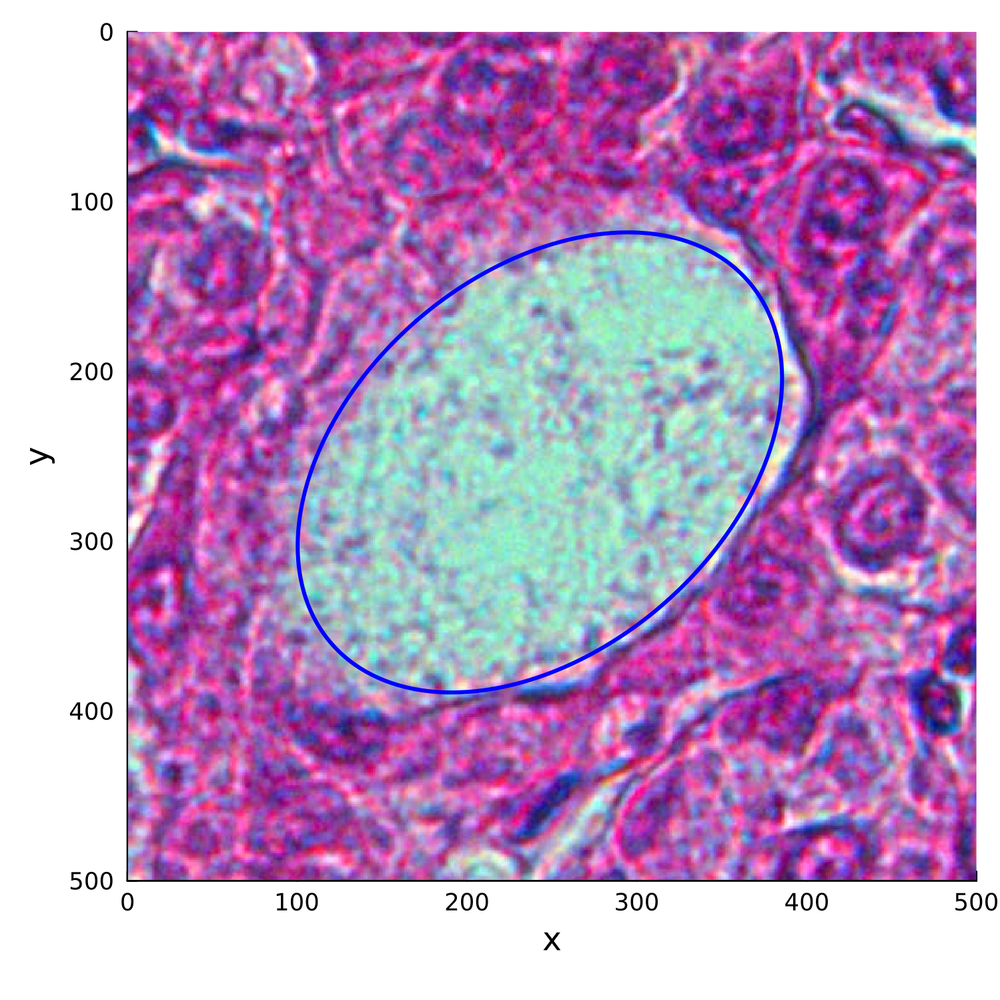

In [299]:
# Create a grid of points for plotting
x_range = 0:1:W
y_range = 0:1:H
X, Y = [x for x in x_range], [y for y in y_range]
Z = zeros(length(X), length(Y))

# Evaluate the quadratic form
function ellipse_eq(x, y, Q, d, e)
    for i in 1:length(x)
        for j in 1:length(y)
            ξ = [x[i], y[j]]
            Z[i, j] = [ξ; 1.0]' * [Q d; d' e] * [ξ; 1.0]
        end
    end
    return Z
end

Z_sq = ellipse_eq(X, Y, Q, d, e)

plt_fit_sq = heatmap(img[end:-1:1, :][x_roi[1]:x_roi[2], y_roi[1]:y_roi[2]], aspect_ratio=1, cbar=false, ylims=(0, 500), xlims=(0, 500), size=(500, 500), dpi=300)
contour!(plt_fit_sq, x_range, y_range, Z, levels=[0.0], linewidth=2, color=:blue, xlabel="x", ylabel="y", cbar=false, label="Squared")
savefig(plt_fit_sq, "liver_tissue_fit_sq.png")
display(plt_fit_sq)

## Optimization problem C2:

$$
\begin{equation}
    \min \max_{\xi_i \in \mathcal{F}} d_\text{res}(\xi_i, \mathcal{E})
\end{equation}
$$

By introducing the variable $\zeta = \max_{\xi_i \in \mathcal{F}} d_\text{res}(\xi_i, \mathcal{E})$ we can reformulate this as:
$$
\begin{equation}
    \min \quad \zeta \quad \text{s.t} \quad \zeta \geq d_\text{res}(\xi_i, \mathcal{E}) \quad \forall i \in N
\end{equation}
$$

In [300]:
@variable(emodel, ζ)
@constraint(emodel, ζ >= 0)
for i in 1:N
    @constraint(emodel, (emodel[:r])[i] <= ζ)
end

In [301]:
obj = @objective(emodel, Min, ζ)
set_objective_function(emodel, obj)
optimize!(emodel)

------------------------------------------------------------------
          COSMO v0.8.9 - A Quadratic Objective Conic Solver
                         Michael Garstka
                University of Oxford, 2017 - 2022
------------------------------------------------------------------

Problem:  x ∈ R^{7},
          constraints: A ∈ R^{4701x7} (32865 nnz),
          matrix size to factor: 4708x4708,
          Floating-point precision: Float64
Sets:     Box of dim: 4694
          DensePsdConeTriangle of dim: 3 (2x2)
          DensePsdConeTriangle of dim: 3 (2x2)
          Nonnegatives of dim: 1
Settings: ϵ_abs = 1.0e-05, ϵ_rel = 1.0e-05,
          ϵ_prim_inf = 1.0e-04, ϵ_dual_inf = 1.0e-04,
          ρ = 0.1, σ = 1e-06, α = 1.6,
          max_iter = 5000,
          scaling iter = 10 (on),
          check termination every 25 iter,
          check infeasibility every 40 iter,
          KKT system solver: QDLDL
Acc:      Anderson Type2{QRDecomp},
          Memory size = 15, RestartedMemory

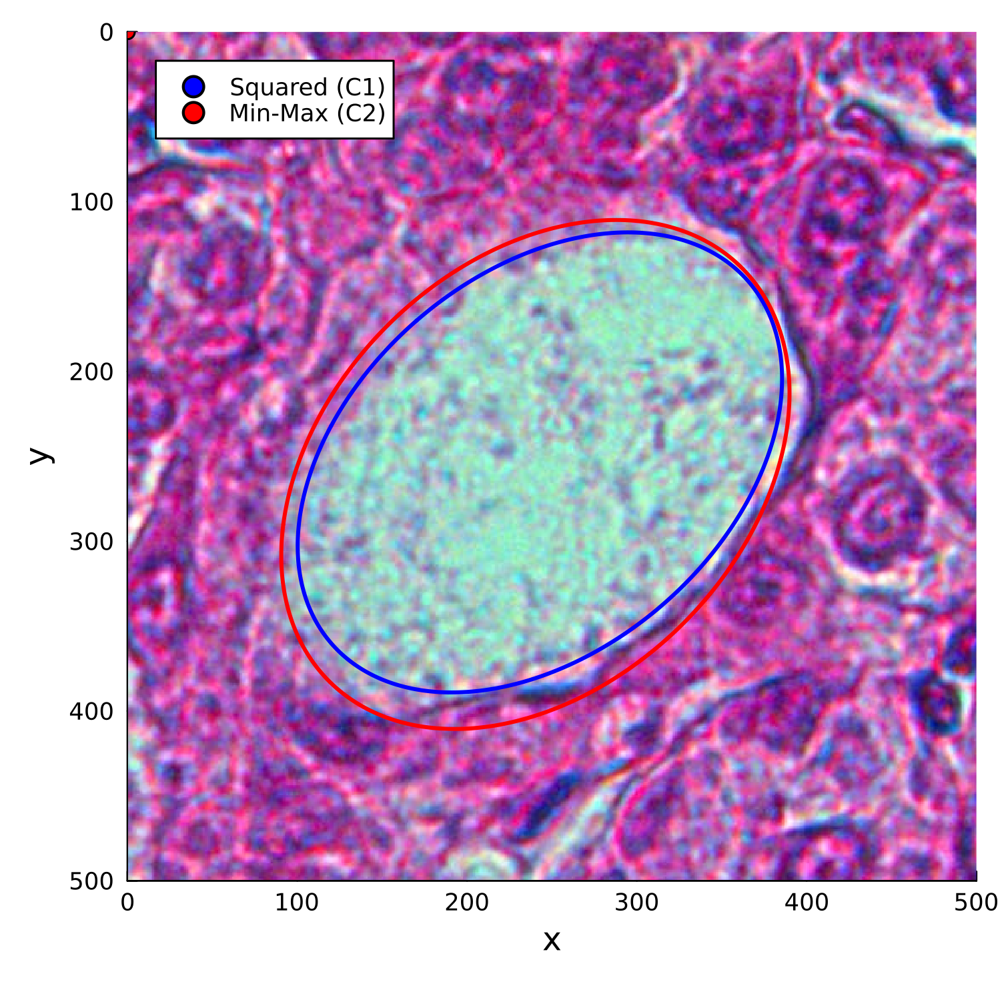

In [302]:
Q, d, e = value.(emodel[:Q]), value.(emodel[:d]), value.(emodel[:e])
Z_minmax = ellipse_eq(X, Y, Q, d, e)

plt_fit_minmax = contour(plt_fit_sq, x_range, y_range, Z_minmax, levels=[0.0], linewidth=2, color=:red, xlabel="x", ylabel="y", bar=false, legend=:topleft, label="Min-Max")

# add a manual legend
scatter!([0], [0], color=:blue, label="Squared (C1)")
scatter!([0], [0], color=:red, label="Min-Max (C2)")
savefig(plt_fit_minmax, "liver_tissue_fit_minimax.png")
display(plt_fit_minmax)

## Optimization problem C3:

Minimize the nearest squared distance.

$$
\begin{equation}
    \min \quad \sum_{i \in N} d_{\text{near}}^2(\xi_i, \mathcal{E})
\end{equation}
$$

The value of $d_{\text{near}}$ is the distance between the point and the nearest point on the ellipse.

$$
\begin{equation}
    d_{\text{near}} = \min_{\xi \in \mathcal{E}} \|\xi - \xi_i\|
\end{equation}
$$

We can reformulate this by introducing a vector of variables $\zeta_i$ such that $\zeta_i = \min_{\xi \in \mathcal{E}} \|\xi - \xi_i\|$:

$$
\begin{equation}
    \min \quad \sum_{i \in N} \zeta_i^2 \quad \text{s.t} \quad \zeta_i \geq \|\xi - \xi_i\| \quad \forall i \in N
\end{equation}
$$


In [303]:
# delete ζ variable
# delete(emodel, ζ)
unregister(emodel, :ζ)

# add vector of slack variables
@variable(emodel, ζ[1:N])
@constraint(emodel, ζ .>= 0)

@constraint(emodel, [i in 1:N], emodel[:r][i] <= ζ[i])

obj = @objective(emodel, Min, sum(ζ[i] for i in 1:N))
set_objective_function(emodel, obj)
optimize!(emodel)

------------------------------------------------------------------
          COSMO v0.8.9 - A Quadratic Objective Conic Solver
                         Michael Garstka
                University of Oxford, 2017 - 2022
------------------------------------------------------------------

Problem:  x ∈ R^{4701},
          constraints: A ∈ R^{14089x4701} (70417 nnz),
          matrix size to factor: 18790x18790,
          Floating-point precision: Float64
Sets:     Box of dim: 9388
          Nonnegatives of dim: 4695
          DensePsdConeTriangle of dim: 3 (2x2)
          DensePsdConeTriangle of dim: 3 (2x2)
Settings: ϵ_abs = 1.0e-05, ϵ_rel = 1.0e-05,
          ϵ_prim_inf = 1.0e-04, ϵ_dual_inf = 1.0e-04,
          ρ = 0.1, σ = 1e-06, α = 1.6,
          max_iter = 5000,
          scaling iter = 10 (on),
          check termination every 25 iter,
          check infeasibility every 40 iter,
          KKT system solver: QDLDL
Acc:      Anderson Type2{QRDecomp},
          Memory size = 15, Res

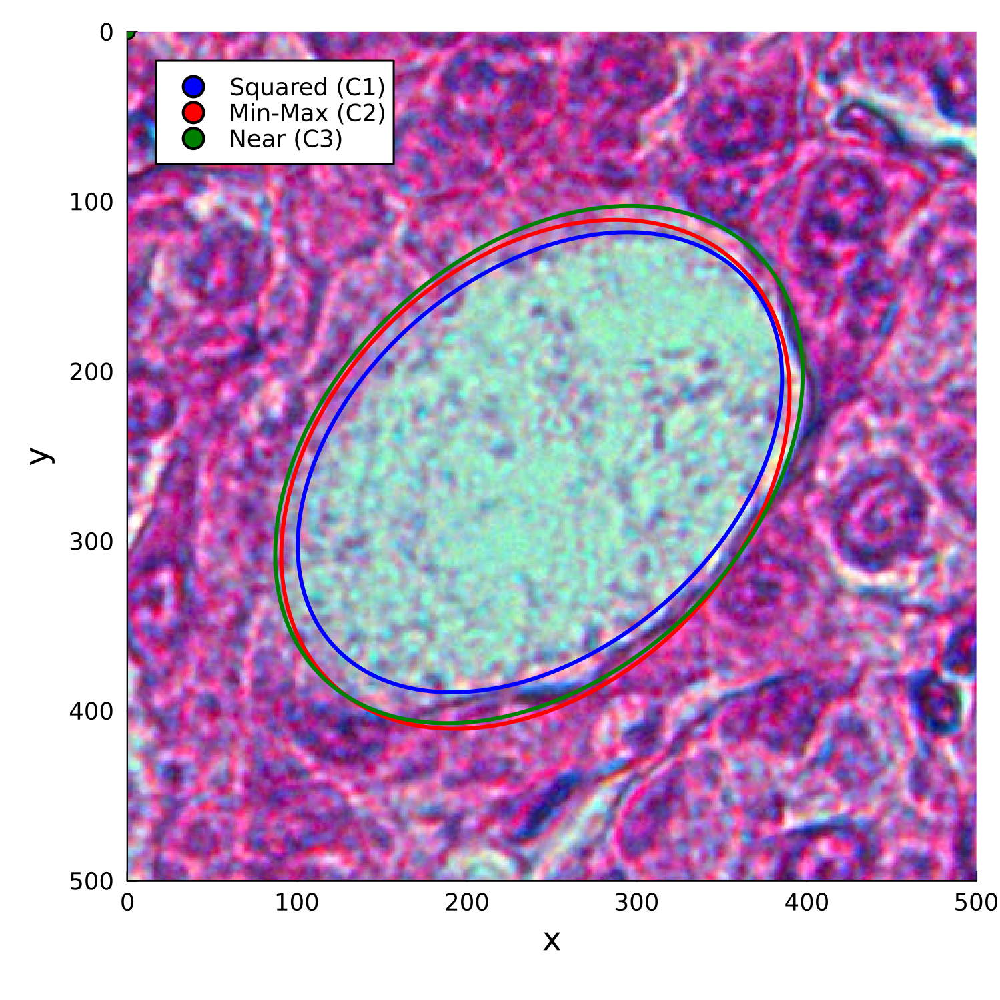

In [305]:
Q, d, e = value.(emodel[:Q]), value.(emodel[:d]), value.(emodel[:e])
Z_near = ellipse_eq(X, Y, Q, d, e)

plt_fit_near = contour(plt_fit_minmax, x_range, y_range, Z_near, levels=[0.0], linewidth=2, color=:green, xlabel="x", ylabel="y", bar=false, legend=:topleft, label="Near")

# add a manual legend
scatter!([0], [0], color=:green, label="Near (C3)")
savefig(plt_fit_near, "liver_tissue_fit_near.png")
display(plt_fit_near)